In [249]:
# importing required libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import re
import time
import seaborn as sns
from collections import Counter
from datetime import datetime
import warnings
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
warnings.filterwarnings("ignore") 
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_colwidth', 300)
import pickle
from wordcloud import WordCloud, STOPWORDS


In [250]:
# importing NLTK libraries
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
from nltk.corpus import stopwords
from nltk import FreqDist
from nltk.tokenize import word_tokenize
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.corpus import wordnet

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\jyome\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\jyome\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\jyome\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\jyome\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [251]:
#Modelling  libraries
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, f1_score, classification_report
from sklearn.naive_bayes import MultinomialNB
import xgboost as xgb


In [252]:
## Set limits for displaying rows and columns

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

In [253]:
# connecting google drive with colab

#from google.colab import drive
#drive.mount('/content/drive')

In [254]:
# Reading file sample30.csv from Google Drive
reviews = pd.read_csv('data/sample30.csv')
reviews.head(5)

,id,brand,categories,manufacturer,name,reviews_date,reviews_didPurchase,reviews_doRecommend,reviews_rating,reviews_text,reviews_title,reviews_userCity,reviews_userProvince,reviews_username,user_sentiment
0,AV13O1A8GV-KLJ3akUyj,Universal Music,"Movies, Music & Books,Music,R&b,Movies & TV,Movie Bundles & Collections,CDs & Vinyl,Rap & Hip-Hop,Bass,Music on CD or Vinyl,Rap,Hip-Hop,Mainstream Rap,Pop Rap",Universal Music Group / Cash Money,Pink Friday: Roman Reloaded Re-Up (w/dvd),2012-11-30T06:21:45.000Z,NaN,NaN,5,i love this album. it's very good. more to the hip hop side than her current pop sound.. SO HYPE! i listen to this everyday at the gym! i give it 5star rating all the way. her metaphors are just crazy.,Just Awesome,Los Angeles,NaN,joshua,Positive
1,AV14LG0R-jtxr-f38QfS,Lundberg,"Food,Packaged Foods,Snacks,Crackers,Snacks, Cookies & Chips,Rice Cakes,Cakes",Lundberg,Lundberg Organic Cinnamon Toast Rice Cakes,2017-07-09T00:00:00.000Z,True,NaN,5,Good flavor. This review was collected as part of a promotion.,Good,NaN,NaN,dorothy w,Positive
2,AV14LG0R-jtxr-f38QfS,Lundberg,"Food,Packaged Foods,Snacks,Crackers,Snacks, Cookies & Chips,Rice Cakes,Cakes",Lundberg,Lundberg Organic Cinnamon Toast Rice Cakes,2017-07-09T00:00:00.000Z,True,NaN,5,Good flavor.,Good,NaN,NaN,dorothy w,Positive
3,AV16khLE-jtxr-f38VFn,K-Y,"Personal Care,Medicine Cabinet,Lubricant/Spermicide,Health,Sexual Wellness,Lubricants",K-Y,K-Y Love Sensuality Pleasure Gel,2016-01-06T00:00:00.000Z,False,False,1,"I read through the reviews on here before looking in to buying one of the couples lubricants, and was ultimately disappointed that it didn't even live up to the reviews I had read. For starters, neither my boyfriend nor I could notice any sort of enhanced or 'captivating' sensation. What we did notice, however, was the messy consistency that was reminiscent of a more liquid-y vaseline. It was difficult to clean up, and was not a pleasant, especially since it lacked the 'captivating' sensation we had both been expecting. I'm disappointed that I paid as much as I did for a lube that I won't use again, when I could just use their normal personal lubricant for 1) less money and 2) less mess.",Disappointed,NaN,NaN,rebecca,Negative
4,AV16khLE-jtxr-f38VFn,K-Y,"Personal Care,Medicine Cabinet,Lubricant/Spermicide,Health,Sexual Wellness,Lubricants",K-Y,K-Y Love Sensuality Pleasure Gel,2016-12-21T00:00:00.000Z,False,False,1,My husband bought this gel for us. The gel caused irritation and it felt like it was burning my skin. I wouldn't recommend this gel.,Irritation,NaN,NaN,walker557,Negative


In [255]:
# Data type of all columns

reviews.dtypes

id                      object
brand                   object
categories              object
manufacturer            object
name                    object
reviews_date            object
reviews_didPurchase     object
reviews_doRecommend     object
reviews_rating           int64
reviews_text            object
reviews_title           object
reviews_userCity        object
reviews_userProvince    object
reviews_username        object
user_sentiment          object
dtype: object

In [256]:
# Shape of the Dataframe 

reviews.shape

(30000, 15)

In [257]:
reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 15 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   id                    30000 non-null  object
 1   brand                 30000 non-null  object
 2   categories            30000 non-null  object
 3   manufacturer          29859 non-null  object
 4   name                  30000 non-null  object
 5   reviews_date          29954 non-null  object
 6   reviews_didPurchase   15932 non-null  object
 7   reviews_doRecommend   27430 non-null  object
 8   reviews_rating        30000 non-null  int64 
 9   reviews_text          30000 non-null  object
 10  reviews_title         29810 non-null  object
 11  reviews_userCity      1929 non-null   object
 12  reviews_userProvince  170 non-null    object
 13  reviews_username      29937 non-null  object
 14  user_sentiment        29999 non-null  object
dtypes: int64(1), object(14)
memory usage

In [258]:
# Total number of null values in each column
reviews.isnull().sum()

id                          0
brand                       0
categories                  0
manufacturer              141
name                        0
reviews_date               46
reviews_didPurchase     14068
reviews_doRecommend      2570
reviews_rating              0
reviews_text                0
reviews_title             190
reviews_userCity        28071
reviews_userProvince    29830
reviews_username           63
user_sentiment              1
dtype: int64

In [259]:
# checking percentage null value for all columns

(reviews.isnull().sum()/30000)*100

id                       0.000000
brand                    0.000000
categories               0.000000
manufacturer             0.470000
name                     0.000000
reviews_date             0.153333
reviews_didPurchase     46.893333
reviews_doRecommend      8.566667
reviews_rating           0.000000
reviews_text             0.000000
reviews_title            0.633333
reviews_userCity        93.570000
reviews_userProvince    99.433333
reviews_username         0.210000
user_sentiment           0.003333
dtype: float64

In [260]:
# here we drop all columns where null percentage is more than 90% 

reviews = reviews.drop(['reviews_userCity','reviews_userProvince'], 1)


In [261]:
# shape of reviews dataframe
reviews.shape

(30000, 13)

In [262]:
reviews.reviews_didPurchase.value_counts()

False    14498
True      1434
Name: reviews_didPurchase, dtype: int64

In [263]:
#Here For null value, I am Assuming that the customer had not purchased the product so, I will fill null values with false values in column reviews_didPurchase.
reviews.reviews_didPurchase.fillna(value=False, inplace=True)


In [264]:
reviews.user_sentiment.value_counts()

Positive    26632
Negative     3367
Name: user_sentiment, dtype: int64

In [265]:
# There is one nan value in the user_sentiment column. after checking the value_counts column we can assume that this nan value is also a Positive one.
#reviews['user_sentiment'] = reviews['user_sentiment'].apply(lambda x : 'Positive' if x == 'nan'else x)
reviews['user_sentiment'] = reviews['user_sentiment'].fillna('Positive')


In [266]:
# checking percentage null value for all columns

(reviews.isnull().sum()/30000)*100

id                     0.000000
brand                  0.000000
categories             0.000000
manufacturer           0.470000
name                   0.000000
reviews_date           0.153333
reviews_didPurchase    0.000000
reviews_doRecommend    8.566667
reviews_rating         0.000000
reviews_text           0.000000
reviews_title          0.633333
reviews_username       0.210000
user_sentiment         0.000000
dtype: float64

In [267]:
reviews.head(2)

,id,brand,categories,manufacturer,name,reviews_date,reviews_didPurchase,reviews_doRecommend,reviews_rating,reviews_text,reviews_title,reviews_username,user_sentiment
0,AV13O1A8GV-KLJ3akUyj,Universal Music,"Movies, Music & Books,Music,R&b,Movies & TV,Movie Bundles & Collections,CDs & Vinyl,Rap & Hip-Hop,Bass,Music on CD or Vinyl,Rap,Hip-Hop,Mainstream Rap,Pop Rap",Universal Music Group / Cash Money,Pink Friday: Roman Reloaded Re-Up (w/dvd),2012-11-30T06:21:45.000Z,False,NaN,5,i love this album. it's very good. more to the hip hop side than her current pop sound.. SO HYPE! i listen to this everyday at the gym! i give it 5star rating all the way. her metaphors are just crazy.,Just Awesome,joshua,Positive
1,AV14LG0R-jtxr-f38QfS,Lundberg,"Food,Packaged Foods,Snacks,Crackers,Snacks, Cookies & Chips,Rice Cakes,Cakes",Lundberg,Lundberg Organic Cinnamon Toast Rice Cakes,2017-07-09T00:00:00.000Z,True,NaN,5,Good flavor. This review was collected as part of a promotion.,Good,dorothy w,Positive


In [268]:
# column type changed from object to string
reviews[['id','brand','categories','manufacturer','name','reviews_text','reviews_title','reviews_username','user_sentiment']] = reviews[['id','brand','categories','manufacturer','name','reviews_text','reviews_title','reviews_username','user_sentiment']].astype(str) 
					

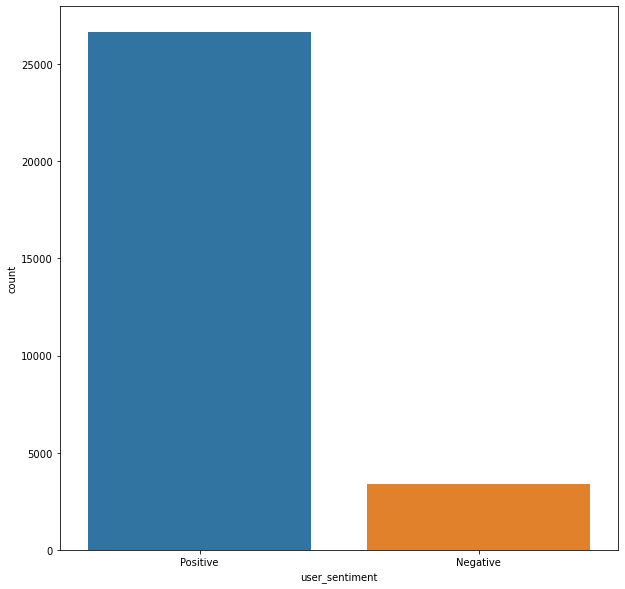

In [269]:
#plotting application data distribution
plt.figure(figsize= (10,10))
sns.countplot(x='user_sentiment', data= reviews)
plt.show()

In [270]:
# Create a new dataframe 'data' with only two columns from the dataframe 'df'
data = reviews[['reviews_text', 'user_sentiment']]

# View five random rows from the newly formed dataframe 'data'
data.sample(5)

,reviews_text,user_sentiment
23780,It's nice to see a new Godzilla movie. This one has a good story and awesome special effects. If you are into science fiction movies I recommend this movie,Positive
16879,I have been a consumer of black rice for many years.This is equal to the quality that I expect.And the price/value is very good.,Positive
5943,John Malcovich and Bruce Willis are hilarious in this first of two movies. The whole family watched while laughing throughout the movie. Would watch over and over.,Positive
3154,this movies is so hilarious. just had to own it myself,Positive
8221,I love Clorox disinfecting Wipes as I have two dogs and a messy grandchild and want to aleviate germs as much as possible. I feel I can always trust Clorox products - nice smell doesn't hurt.,Positive


In [271]:
# rename the column reviews_text in new df 
data.rename(columns = {'reviews_text':'reviews'}, inplace = True)


## **Text Preprocessing**

In [272]:
# Remove punctuation 
data['reviews'] = data['reviews'].str.replace('[^\w\s]','')

In [273]:
# Remove Stopwords
stopword_list = stopwords.words('english')
data['reviews'] = data['reviews'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stopword_list)]))

In [274]:
# function to remove unneccessary, non-ascii values and digits
def scrub_words(text):
    """Basic cleaning of texts."""
      
    # remove unneccessary words
    text = text.replace("RE:","")
    text = text.replace("FW:","")
    
    #remove non-ascii and digits
    text=re.sub("(\\W|\\d)"," ",text)
    
    #remove whitespace
    text = text.strip()
    text = re.sub(' +', ' ',text)
    
    return text

In [275]:
# appling scrub_words function on reviews_text column
data['reviews']=data['reviews'].apply(lambda x: scrub_words(x))

In [276]:
# change all text to lower for column reviews_text 
data['reviews']= data['reviews'].str.lower()

In [277]:
lemmatizer = nltk.stem.WordNetLemmatizer()

In [278]:
def nltk_tag_to_wordnet_tag(nltk_tag):
    if nltk_tag.startswith('J'):
        return wordnet.ADJ
    elif nltk_tag.startswith('V'):
        return wordnet.VERB
    elif nltk_tag.startswith('N'):
        return wordnet.NOUN
    elif nltk_tag.startswith('R'):
        return wordnet.ADV
    else:
        return None

In [279]:
def lemmatize_sentence(sentence):
    #tokenize the sentence and find the POS tag for each token
    nltk_tagged = nltk.pos_tag(nltk.word_tokenize(sentence))
    #tuple of (token, wordnet_tag)
    wordnet_tagged = map(lambda x: (x[0], nltk_tag_to_wordnet_tag(x[1])), nltk_tagged)
    lemmatized_sentence = []
    for word, tag in wordnet_tagged:
        if tag is None:
            #if there is no available tag, append the token as is
            lemmatized_sentence.append(word)
        else:
            #else use the tag to lemmatize the token
            lemmatized_sentence.append(lemmatizer.lemmatize(word, tag))
    return " ".join(lemmatized_sentence)

In [280]:
# Lemmatized the reviews text using above helper function
data['reviews'] = data['reviews'].apply(lambda x: lemmatize_sentence(x))

# View the first 10 rows of lemmatized columns
data.head(10)

,reviews,user_sentiment
0,love album good hip hop side current pop sound so hype listen everyday gym give star rating way metaphor crazy,Positive
1,good flavor this review collect part promotion,Positive
2,good flavor,Positive
3,i read review look buy one couple lubricant ultimately disappointed didnt even live review i read for starter neither boyfriend i could notice sort enhanced captivate sensation what notice however messy consistency reminiscent liquidy vaseline it difficult clean pleasant especially since lack captivate sensation expect im disappoint i pay much i lube i wont use i could use normal personal lubricant less money less mess,Negative
4,my husband buy gel us the gel cause irritation felt like burn skin i wouldnt recommend gel,Negative
5,my boyfriend i buy spice thing bedroom highly disappointed product we buy one absolutely love ky mine think would similar affect absolutely nothing do buy,Negative
6,buy earlier today excite check base product description i expect something like regular ky we fan expect left little disappointed,Negative
7,i buy product husband i try impressed there tingle warm it leave us sticky i use ky product past loved ky one disappointing,Negative
8,my husband i buy extra fun we werevboth extremely disappointed especially price do waste money product we felt nothing sticky mess,Negative
9,get surprise husband nothing special lube save money get plain ky need lube wish i could return refund,Positive


## Data Visualization


In [281]:
# Create list of lengths of reviews
doc_lens = [len(d) for d in data['reviews']]
doc_lens[:5]

[110, 46, 11, 422, 90]

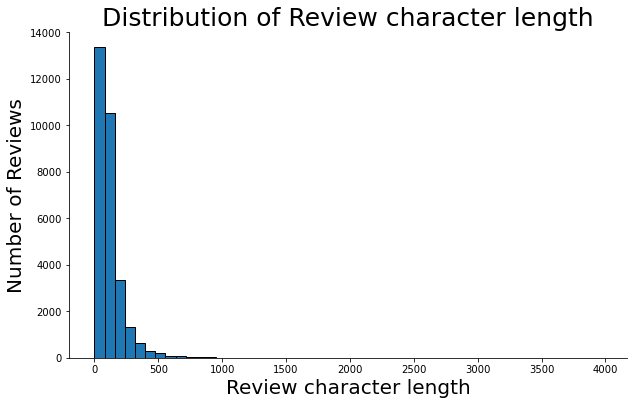

In [282]:
# Plot the data according to character length of complaints
plt.figure(figsize=(10,6))
plt.hist(doc_lens, edgecolor='black', bins = 50)
plt.title('Distribution of Review character length', fontsize=25)
plt.ylabel('Number of Reviews', fontsize=20)
plt.xlabel('Review character length', fontsize=20)
sns.despine()
plt.show()

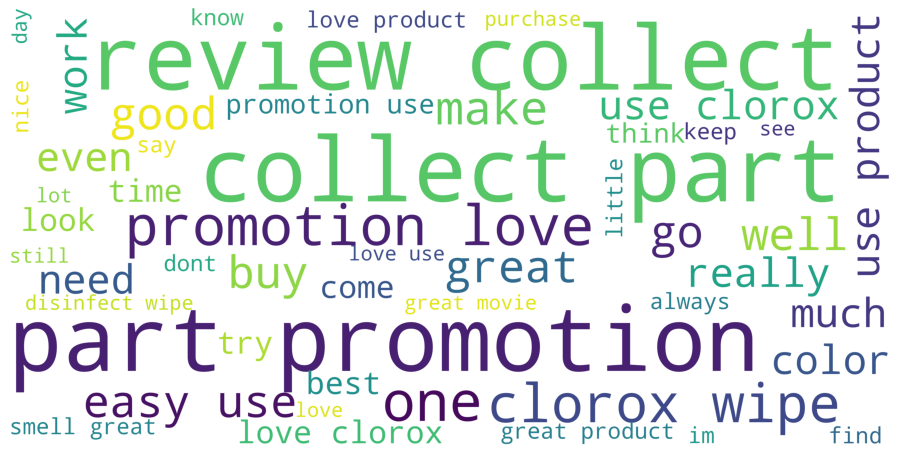

In [283]:
# Word cloud showing the top 50 words by frequency among all the reviews after processing the text
stopwords = set(STOPWORDS)
wordcloud = WordCloud(
                          background_color='White',
                          stopwords=stopwords,
                          max_words=50,
                          max_font_size=40,
                          scale=30,
                          random_state=42
                         ).generate(str(data['reviews']))

fig = plt.figure(figsize=(16,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

In [284]:
# Save the preprocessed data for future use
pickle.dump(data, open('pickle/processed_data.pkl', 'wb'))

In [285]:
data.isnull().sum()

reviews           0
user_sentiment    0
dtype: int64

### Feature Extraction 

In [286]:
word_vectorizer = TfidfVectorizer(
    strip_accents='unicode',    # Remove accents and perform other character normalization during the preprocessing step. 
    analyzer='word',            # Whether the feature should be made of word or character n-grams.
    token_pattern=r'\w{1,}',    # Regular expression denoting what constitutes a “token”, only used if analyzer == 'word'
    ngram_range=(1, 3),         # The lower and upper boundary of the range of n-values for different n-grams to be extracted
    stop_words='english',
    sublinear_tf=True)

#word_vectorizer.fit(X_train)    # Fiting it on Train
X_word_features = word_vectorizer.fit_transform(data['reviews'])  # Transform on Train

In [287]:
# View the sparse feature matrix
print(X_word_features)

  (0, 445189)	0.16303833006301488
  (0, 325138)	0.16303833006301488
  (0, 382245)	0.16303833006301488
  (0, 177077)	0.16303833006301488
  (0, 125917)	0.16303833006301488
  (0, 232595)	0.16303833006301488
  (0, 197858)	0.16303833006301488
  (0, 377088)	0.16303833006301488
  (0, 304407)	0.16303833006301488
  (0, 88424)	0.16303833006301488
  (0, 192743)	0.16303833006301488
  (0, 189774)	0.16303833006301488
  (0, 163900)	0.16303833006301488
  (0, 7854)	0.16303833006301488
  (0, 241600)	0.16303833006301488
  (0, 257836)	0.16303833006301488
  (0, 445188)	0.16303833006301488
  (0, 325137)	0.16303833006301488
  (0, 382237)	0.135520441285013
  (0, 177076)	0.16303833006301488
  (0, 125916)	0.16303833006301488
  (0, 232594)	0.16303833006301488
  (0, 197857)	0.16303833006301488
  (0, 377087)	0.16303833006301488
  (0, 304406)	0.16303833006301488
  :	:
  (29999, 388635)	0.12275115033948174
  (29999, 129973)	0.15298573591735032
  (29999, 34215)	0.12961718728609375
  (29999, 202749)	0.0793724217815814

In [288]:
# Save vocabulary of TF-IDF to a pickle file
pickle.dump(word_vectorizer.vocabulary_, open("pickle/tfidf_vocab.pkl","wb"))

In [289]:

# Create feature variable X and target variable y
X = X_word_features
y = data['user_sentiment']

In [290]:
# number of classes in user_sentiment columns
no_of_classes= len(pd.Series(y).value_counts())

In [291]:
#Distribution of the target variable data in terms of proportions.
print("Percent of Positives: ".format(0), round(100*pd.Series(y).value_counts()[0]/pd.Series(y).value_counts().sum(),2), "%")
print("Percent of Positives: ".format(1), round(100*pd.Series(y).value_counts()[1]/pd.Series(y).value_counts().sum(),2), "%")

Percent of Positives:  88.78 %
Percent of Positives:  11.22 %


In [292]:
# Split the dataset into test and train

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=100)

In [293]:

# # Print the shape of each dataset.
print('Shape of X_train_transformed', X_train.shape)
print('Shape of y_train', y_train.shape)
print('Shape of X_test_transformed', X_test.shape)
print('Shape of y_test', y_test.shape)

Shape of X_train_transformed (21000, 466307)
Shape of y_train (21000,)
Shape of X_test_transformed (9000, 466307)
Shape of y_test (9000,)


## Model -1 : Logistic Regression Model

In [294]:
# Building the Logistic Regression model with imbalance data
time1 = time.time()

logit = LogisticRegression()
logit.fit(X_train,y_train)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Time Taken: 13.04 seconds


In [295]:
# Prediction on Train Data
y_pred_train_logi= logit.predict(X_train)

#Model Performance on Train Dataset
print("Logistic Regression Accuracy on Train Data", accuracy_score(y_pred_train_logi, y_train))
print(classification_report(y_pred_train_logi, y_train))

Logistic Regression Accuracy on Train Data 0.8995238095238095
              precision    recall  f1-score   support

    Negative       0.11      0.98      0.19       254
    Positive       1.00      0.90      0.95     20746

    accuracy                           0.90     21000
   macro avg       0.55      0.94      0.57     21000
weighted avg       0.99      0.90      0.94     21000



In [296]:
# Prediction Test Data
y_pred_test_logi = logit.predict(X_test)

#Model Performance on Test Dataset
print("Logistic Regression Accuracy on Test Data", accuracy_score(y_pred_test_logi, y_test))
print(classification_report(y_pred_test_logi, y_test))

Logistic Regression Accuracy on Test Data 0.8908888888888888
              precision    recall  f1-score   support

    Negative       0.03      0.89      0.06        37
    Positive       1.00      0.89      0.94      8963

    accuracy                           0.89      9000
   macro avg       0.52      0.89      0.50      9000
weighted avg       1.00      0.89      0.94      9000



### Smote Technique for imbalanced data

In [297]:
# Applying smote for imbalance data
counter = Counter(y_train)
print('Before',counter)
# download imblearn library
sm = SMOTE()

# transform the dataset
X_train_sm, y_train_sm = sm.fit_resample(X_train, y_train)

counter = Counter(y_train_sm)
print('After',counter)

Before Counter({'Positive': 18644, 'Negative': 2356})
After Counter({'Positive': 18644, 'Negative': 18644})


In [298]:
# Building the Logistic Regression model after Smote
time1 = time.time()

logit_sm = LogisticRegression()
logit_sm.fit(X_train_sm,y_train_sm)

time_taken = time.time() - time1
print('Time Taken in logestic regression with smote: {:.2f} seconds'.format(time_taken))

Time Taken in logestic regression with smote: 16.02 seconds


In [299]:
# Prediction on Train Data
y_pred_train_sm_logi= logit_sm.predict(X_train_sm)

print("-----------------------------------------------------------")
print("Logistic Regression Model Performance on Train Dataset")
print("-----------------------------------------------------------")
acc_logi_train = accuracy_score(y_pred_train_sm_logi, y_train_sm)
print("Accuracy = ", acc_logi_train)
print("-----------------------------------------------------------")

f1_logi_train = f1_score(y_train_sm, y_pred_train_sm_logi, average="weighted")
print("F1 Score = ",f1_logi_train)
print("-----------------------------------------------------------")

print(classification_report(y_pred_train_sm_logi, y_train_sm))
print("-----------------------------------------------------------")

print(confusion_matrix(y_pred_train_sm_logi, y_train_sm))
print("-----------------------------------------------------------")


-----------------------------------------------------------
Logistic Regression Model Performance on Train Dataset
-----------------------------------------------------------
Accuracy =  0.9868054065651147
-----------------------------------------------------------
F1 Score =  0.9868040790339344
-----------------------------------------------------------
              precision    recall  f1-score   support

    Negative       1.00      0.98      0.99     19018
    Positive       0.98      1.00      0.99     18270

    accuracy                           0.99     37288
   macro avg       0.99      0.99      0.99     37288
weighted avg       0.99      0.99      0.99     37288

-----------------------------------------------------------
[[18585   433]
 [   59 18211]]
-----------------------------------------------------------


In [300]:
# Prediction on Test Data
y_pred_test_sm_logi = logit_sm.predict(X_test)

print("-----------------------------------------------------------")
print("Logistic Regression Model Performance on Test Dataset")

print("-----------------------------------------------------------")
acc_logi_test = accuracy_score(y_pred_test_sm_logi, y_test)
print("Accuracy", acc_logi_test)

print("-----------------------------------------------------------")
f1_logi_test = f1_score(y_test, y_pred_test_sm_logi, average="weighted")
print("F1 Score ",f1_logi_test)

print("-----------------------------------------------------------")
print(classification_report(y_pred_test_sm_logi, y_test))

print("-----------------------------------------------------------")

print(confusion_matrix(y_pred_test_sm_logi, y_test))
print("-----------------------------------------------------------")


-----------------------------------------------------------
Logistic Regression Model Performance on Test Dataset
-----------------------------------------------------------
Accuracy 0.9121111111111111
-----------------------------------------------------------
F1 Score  0.9157948600459753
-----------------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.72      0.59      0.65      1230
    Positive       0.94      0.96      0.95      7770

    accuracy                           0.91      9000
   macro avg       0.83      0.78      0.80      9000
weighted avg       0.91      0.91      0.91      9000

-----------------------------------------------------------
[[ 725  505]
 [ 286 7484]]
-----------------------------------------------------------


In [301]:
# New dataframe named model_result to store F1 Scores of all models we will build
model_result = pd.DataFrame([{'Model': 'Logistic Regression','F1 Score ': acc_logi_test, 
                         'Accuracy': f1_logi_test}])
model_result

,Model,F1 Score,Accuracy
0,Logistic Regression,0.912111,0.915795


## Model - 2 : Random Forest Model

In [302]:
# Building Random Forest Model
time1 = time.time()

classifier = RandomForestClassifier(n_estimators=100, random_state=100, n_jobs=-1)
classifier.fit(X_train_sm,y_train_sm)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Time Taken: 183.71 seconds


In [303]:

# Prediction on Train Data
y_pred_train_rf= classifier.predict(X_train_sm)

print("-----------------------------------------------------------")
print("Random Forest Model Performance on Train Dataset")
print("-----------------------------------------------------------")

acc_rf_train = accuracy_score(y_pred_train_rf, y_train_sm)
print("Accuracy = ", acc_rf_train)
print("-----------------------------------------------------------")

f1_rf_train = f1_score(y_train_sm, y_pred_train_rf, average="weighted")
print("F1 Score = ",f1_rf_train)
print("-----------------------------------------------------------")

print(classification_report(y_pred_train_rf, y_train_sm))
print("-----------------------------------------------------------")

print(confusion_matrix(y_pred_train_rf, y_train_sm))
print("-----------------------------------------------------------")

-----------------------------------------------------------
Random Forest Model Performance on Train Dataset
-----------------------------------------------------------
Accuracy =  0.9998122720446256
-----------------------------------------------------------
F1 Score =  0.9998122720434104
-----------------------------------------------------------
              precision    recall  f1-score   support

    Negative       1.00      1.00      1.00     18647
    Positive       1.00      1.00      1.00     18641

    accuracy                           1.00     37288
   macro avg       1.00      1.00      1.00     37288
weighted avg       1.00      1.00      1.00     37288

-----------------------------------------------------------
[[18642     5]
 [    2 18639]]
-----------------------------------------------------------


In [304]:
# Prediction Test Data



# Prediction on Test Data
y_pred_test_rf = classifier.predict(X_test)

print("-----------------------------------------------------------")
print("Random Forest Model Performance on Test Dataset")
print("-----------------------------------------------------------")

acc_rf_test = accuracy_score(y_pred_test_rf, y_test)
print("Accuracy = ", acc_rf_test)
print("-----------------------------------------------------------")

f1_rf_test = f1_score(y_test, y_pred_test_rf, average="weighted")
print("F1 Score = ",f1_rf_test)
print("-----------------------------------------------------------")

print(classification_report(y_pred_test_rf, y_test))
print("-----------------------------------------------------------")

print(confusion_matrix(y_pred_test_rf, y_test))
print("-----------------------------------------------------------")

-----------------------------------------------------------
Random Forest Model Performance on Test Dataset
-----------------------------------------------------------
Accuracy =  0.9102222222222223
-----------------------------------------------------------
F1 Score =  0.8958697533920368
-----------------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.34      0.71      0.46       485
    Positive       0.98      0.92      0.95      8515

    accuracy                           0.91      9000
   macro avg       0.66      0.82      0.71      9000
weighted avg       0.95      0.91      0.92      9000

-----------------------------------------------------------
[[ 344  141]
 [ 667 7848]]
-----------------------------------------------------------


In [305]:

# Update the summary table
model_result.loc[len(model_result.index)] = ['Random Forest', f1_rf_test, acc_rf_test]
model_result

,Model,F1 Score,Accuracy
0,Logistic Regression,0.912111,0.915795
1,Random Forest,0.895870,0.910222


## Model - 3 : XGBoost

In [306]:
# Building the XGBoost Model
time1 = time.time()

xgclf = xgb.XGBClassifier()
xgclf.fit(X_train_sm,y_train_sm)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

[21:53:10] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Time Taken: 31.19 seconds


In [307]:
# Prediction Train Data


# Prediction on Train Data
y_pred_train_xg= xgclf.predict(X_train_sm)

print("-----------------------------------------------------------")
print("XGBoost Model Performance on Train Dataset")
print("-----------------------------------------------------------")

acc_xg_train = accuracy_score(y_pred_train_xg, y_train_sm)
print("Accuracy = ", acc_xg_train)
print("-----------------------------------------------------------")

f1_xg_train = f1_score(y_train_sm, y_pred_train_xg, average="weighted")
print("F1 Score = ",f1_xg_train)
print("-----------------------------------------------------------")

print(classification_report(y_pred_train_xg, y_train_sm))
print("-----------------------------------------------------------")

print(confusion_matrix(y_pred_train_xg, y_train_sm))
print("-----------------------------------------------------------")

-----------------------------------------------------------
XGBoost Model Performance on Train Dataset
-----------------------------------------------------------
Accuracy =  0.9596653078738469
-----------------------------------------------------------
F1 Score =  0.9596439407953081
-----------------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.98      0.94      0.96     19502
    Positive       0.94      0.98      0.96     17786

    accuracy                           0.96     37288
   macro avg       0.96      0.96      0.96     37288
weighted avg       0.96      0.96      0.96     37288

-----------------------------------------------------------
[[18321  1181]
 [  323 17463]]
-----------------------------------------------------------


In [308]:
# Prediction Test Data

y_pred_test_xg = xgclf.predict(X_test)

print("-----------------------------------------------------------")
print("XGBoost Model Performance on Test Dataset")
print("-----------------------------------------------------------")

acc_xg_test = accuracy_score(y_pred_test_xg, y_test)
print("Accuracy = ", acc_xg_test)
print("-----------------------------------------------------------")

f1_xg_test = f1_score(y_test, y_pred_test_xg, average="weighted")
print("F1 Score = ",f1_xg_test)
print("-----------------------------------------------------------")

print(classification_report(y_pred_test_xg, y_test))
print("-----------------------------------------------------------")

print(confusion_matrix(y_pred_test_xg, y_test))
print("-----------------------------------------------------------")

-----------------------------------------------------------
XGBoost Model Performance on Test Dataset
-----------------------------------------------------------
Accuracy =  0.905
-----------------------------------------------------------
F1 Score =  0.9123329836453761
-----------------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.80      0.55      0.65      1466
    Positive       0.92      0.97      0.94      7534

    accuracy                           0.91      9000
   macro avg       0.86      0.76      0.80      9000
weighted avg       0.90      0.91      0.90      9000

-----------------------------------------------------------
[[ 811  655]
 [ 200 7334]]
-----------------------------------------------------------


In [309]:

# Update the summary table
model_result.loc[len(model_result.index)] = ['XGBoost', f1_xg_test, acc_xg_test]
model_result

,Model,F1 Score,Accuracy
0,Logistic Regression,0.912111,0.915795
1,Random Forest,0.895870,0.910222
2,XGBoost,0.912333,0.905000


## Model - 4 : Naive Bayes

In [310]:
# Building the Naive Bayes Model
time1 = time.time()

mnb = MultinomialNB()
mnb.fit(X_train_sm,y_train_sm)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Time Taken: 0.38 seconds


In [311]:
# Prediction on Train Data
y_pred_train_nb= mnb.predict(X_train_sm)

print("-----------------------------------------------------------")
print("Naive Bayes Model Performance on Train Dataset")
print("-----------------------------------------------------------")

acc_nb_train = accuracy_score(y_pred_train_nb, y_train_sm)
print("Accuracy = ", acc_nb_train)
print("-----------------------------------------------------------")

f1_nb_train = f1_score(y_train_sm, y_pred_train_nb, average="weighted")
print("F1 Score = ",f1_nb_train)
print("-----------------------------------------------------------")

print(classification_report(y_pred_train_nb, y_train_sm))
print("-----------------------------------------------------------")

print(confusion_matrix(y_pred_train_nb, y_train_sm))
print("-----------------------------------------------------------")

-----------------------------------------------------------
Naive Bayes Model Performance on Train Dataset
-----------------------------------------------------------
Accuracy =  0.9860813130229564
-----------------------------------------------------------
F1 Score =  0.9860793658791928
-----------------------------------------------------------
              precision    recall  f1-score   support

    Negative       1.00      0.97      0.99     19085
    Positive       0.97      1.00      0.99     18203

    accuracy                           0.99     37288
   macro avg       0.99      0.99      0.99     37288
weighted avg       0.99      0.99      0.99     37288

-----------------------------------------------------------
[[18605   480]
 [   39 18164]]
-----------------------------------------------------------


In [312]:
# Prediction Test Data

y_pred_test_nb = mnb.predict(X_test)

print("-----------------------------------------------------------")
print("Naive Bayes Model Performance on Test Dataset")
print("-----------------------------------------------------------")

acc_nb_test = accuracy_score(y_pred_test_nb, y_test)
print("Accuracy = ", acc_nb_test)
print("-----------------------------------------------------------")

f1_nb_test = f1_score(y_test, y_pred_test_nb, average="weighted")
print("F1 Score = ",f1_nb_test)
print("-----------------------------------------------------------")

print(classification_report(y_pred_test_nb, y_test))
print("-----------------------------------------------------------")

print(confusion_matrix(y_pred_test_nb, y_test))
print("-----------------------------------------------------------")

-----------------------------------------------------------
Naive Bayes Model Performance on Test Dataset
-----------------------------------------------------------
Accuracy =  0.8738888888888889
-----------------------------------------------------------
F1 Score =  0.8826307631138675
-----------------------------------------------------------
              precision    recall  f1-score   support

    Negative       0.64      0.46      0.53      1408
    Positive       0.90      0.95      0.93      7592

    accuracy                           0.87      9000
   macro avg       0.77      0.70      0.73      9000
weighted avg       0.86      0.87      0.87      9000

-----------------------------------------------------------
[[ 642  766]
 [ 369 7223]]
-----------------------------------------------------------


In [313]:

# Update the summary table
model_result.loc[len(model_result.index)] = ['Naive Bayes', f1_nb_test, acc_nb_test]
model_result

,Model,F1 Score,Accuracy
0,Logistic Regression,0.912111,0.915795
1,Random Forest,0.895870,0.910222
2,XGBoost,0.912333,0.905000
3,Naive Bayes,0.882631,0.873889


### From the above summary table, we compare all the models built and select the `Logistic Regression` model. There are two reasons we select this model:-

### 1. This model gives the highest `weighted F1 Score` and `Accuracy`

### 2. It takes much less time to train than other models giving same `weighted F1 Score`



<br>
<br>

### Train this model on the full data  so that it can learn more patterns from the data.

In [314]:
# Applying smote for imbalance data
counter = Counter(y)
print('Before',counter)
# download imblearn library
sm2 = SMOTE()

# transform the dataset
X_transformed_sm, y_sm = sm2.fit_resample(X, y)

counter = Counter(y_sm)
print('After',counter)

Before Counter({'Positive': 26633, 'Negative': 3367})
After Counter({'Positive': 26633, 'Negative': 26633})


In [315]:
# Run Logistic Regression on full data
time1 = time.time()

logit_final = LogisticRegression(random_state=100)
logit_final.fit(X_transformed_sm, y_sm)

time_taken = time.time() - time1
print('Time Taken in logestic regression with smote: {:.2f} seconds'.format(time_taken))

Time Taken in logestic regression with smote: 20.88 seconds


In [316]:
# Save tuned Logistic Regression model as pickle file
pickle.dump(logit_final, open("pickle/logreg_model.pkl", "wb"))

## Building a Recommendation System
 

In [317]:
reviews.head(2)

,id,brand,categories,manufacturer,name,reviews_date,reviews_didPurchase,reviews_doRecommend,reviews_rating,reviews_text,reviews_title,reviews_username,user_sentiment
0,AV13O1A8GV-KLJ3akUyj,Universal Music,"Movies, Music & Books,Music,R&b,Movies & TV,Movie Bundles & Collections,CDs & Vinyl,Rap & Hip-Hop,Bass,Music on CD or Vinyl,Rap,Hip-Hop,Mainstream Rap,Pop Rap",Universal Music Group / Cash Money,Pink Friday: Roman Reloaded Re-Up (w/dvd),2012-11-30T06:21:45.000Z,False,NaN,5,i love this album. it's very good. more to the hip hop side than her current pop sound.. SO HYPE! i listen to this everyday at the gym! i give it 5star rating all the way. her metaphors are just crazy.,Just Awesome,joshua,Positive
1,AV14LG0R-jtxr-f38QfS,Lundberg,"Food,Packaged Foods,Snacks,Crackers,Snacks, Cookies & Chips,Rice Cakes,Cakes",Lundberg,Lundberg Organic Cinnamon Toast Rice Cakes,2017-07-09T00:00:00.000Z,True,NaN,5,Good flavor. This review was collected as part of a promotion.,Good,dorothy w,Positive


In [318]:
# New Split of data in test and train for Recommendation System
reviews2 = pd.read_csv('data/sample30.csv')
train2, test2 = train_test_split(reviews2, test_size=0.30, random_state=100)

In [319]:
# shape of the train and test data
print(train2.shape)
print(test2.shape)

(21000, 15)
(9000, 15)


In [320]:
# Pivot the train reviews' dataset into matrix format in which columns are item name and the rows are reviews_username.
df_pivot = train2.pivot_table(
    index='reviews_username',
    columns='name',
    values='reviews_rating',
    aggfunc='mean'
).fillna(0)

df_pivot.head(3)

name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,5302050 15/16 FCT/HOSE ADAPTOR,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,Alex Cross (dvdvideo),"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz",Avery174 11-1/4 X 9-1/4 Index Maker Extra Wide Label Dividers With 5 Tab - Clear (5 Sets Per Pack),"Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"BRIDGESTONE 130/70ZR18M/C(63W)FRONT EXEDRA G851, CRUISER RADL","Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,"Beanitos Bean Chips, Simply Pinto Bean",Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint","Better Built 74010862 Bet74010862 60In Crossover Two Lid, Deep, Truck Tool Box",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,"Bodycology Nourishing Body Cream, Pretty In Paris",Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,"Carson-Dellosa Publishing Photographic Learning Cards Boxed Set, Nouns/verbs/adjectives, Grades K-12",Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Charcoal Stone Toothbrush Holder Gray,Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Citrus Magic Instant Spot & Stain Remover,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Cococare 100% Natural Castor Oil,"Colorganics Lipstick, Cayenne",Concept Housewares 36 Natural Wood ceiling mounted pot rack,Coola Organic Sunscreen Classic Face Cucumber SPF 30,"Coty Airspun Face Powder, Translucent Extra Coverage",Craft Punch Giga Scallop Circle 45 24687534 To 334,"Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Elvis Presley - Girl Happy (cd),Equals (blu-Ray),Every Man Jack Pomade Signature Mint Scent,Fantas

In [321]:
mean = np.nanmean(df_pivot, axis=1)
df_subtracted = (df_pivot.T-mean).T

### Creating dummy train & dummy test dataset for prediction

- Dummy train will be used for prediction of the items which has not been rated by the user. To ignore the items rated by the user, we will mark it as 0 during prediction. The items not rated by user is marked as 1 for prediction in dummy train dataset. 

- Dummy test will be used for evaluation. To evaluate, we will only make prediction on the items rated by the user. So, this is marked as 1. This is just opposite of dummy_train.

In [322]:
# Copy the train dataset into dummy_train
dummy_train = train2.copy()

In [323]:
# The items which was not rated by user is marked as 1 for prediction. 
dummy_train['reviews_rating'] = dummy_train['reviews_rating'].apply(lambda x: 0 if x>=1 else 1)

In [324]:
# Convert the dummy train dataset into matrix format.
dummy_train = dummy_train.pivot_table(
    index='reviews_username',
    columns='name',
    values='reviews_rating',
    aggfunc='mean'
).fillna(1)

In [325]:
dummy_train.head()

name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,5302050 15/16 FCT/HOSE ADAPTOR,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,Alex Cross (dvdvideo),"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz",Avery174 11-1/4 X 9-1/4 Index Maker Extra Wide Label Dividers With 5 Tab - Clear (5 Sets Per Pack),"Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"BRIDGESTONE 130/70ZR18M/C(63W)FRONT EXEDRA G851, CRUISER RADL","Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,"Beanitos Bean Chips, Simply Pinto Bean",Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint","Better Built 74010862 Bet74010862 60In Crossover Two Lid, Deep, Truck Tool Box",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,"Bodycology Nourishing Body Cream, Pretty In Paris",Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,"Carson-Dellosa Publishing Photographic Learning Cards Boxed Set, Nouns/verbs/adjectives, Grades K-12",Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Charcoal Stone Toothbrush Holder Gray,Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Citrus Magic Instant Spot & Stain Remover,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Cococare 100% Natural Castor Oil,"Colorganics Lipstick, Cayenne",Concept Housewares 36 Natural Wood ceiling mounted pot rack,Coola Organic Sunscreen Classic Face Cucumber SPF 30,"Coty Airspun Face Powder, Translucent Extra Coverage",Craft Punch Giga Scallop Circle 45 24687534 To 334,"Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Elvis Presley - Girl Happy (cd),Equals (blu-Ray),Every Man Jack Pomade Signature Mint Scent,Fantas

# User Similarity Matrix

## Using Cosine Similarity

In [326]:
from sklearn.metrics.pairwise import pairwise_distances

# Creating the User Similarity Matrix using pairwise_distance function.
user_correlation = 1 - pairwise_distances(df_pivot, metric='cosine')
user_correlation[np.isnan(user_correlation)] = 0
print(user_correlation)

[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 1. 0.]
 [0. 0. 0. ... 1. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]


In [327]:
user_correlation.shape

(18201, 18201)

## Prediction for User - User based Recommendation

In [328]:
# Doing the prediction for the users which are positively related with other users, 
# and not the users which are negatively related as we are interested in the users 
# which are more similar to the current users. 
# So, ignoring the correlation for values less than 0. 

In [329]:
user_correlation[user_correlation<0]=0
user_correlation

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 1., 0.],
       [0., 0., 0., ..., 1., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

In [330]:
user_predicted_ratings = np.dot(user_correlation, df_pivot.fillna(0))
user_predicted_ratings

array([[ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  4.74370473,  0.        , ...,  6.09691768,
         0.        ,  0.61084722],
       [ 0.        , 18.03851247,  0.        , ..., 24.5986603 ,
         2.21348628,  2.9505076 ],
       ...,
       [ 0.        ,  1.73421994,  0.        , ..., 12.11032203,
         2.5       ,  0.        ],
       [ 0.        ,  1.73421994,  0.        , ..., 12.11032203,
         2.5       ,  0.        ],
       [ 0.        ,  0.        ,  0.        , ...,  6.99393678,
         2.49017207,  0.        ]])

In [331]:
user_predicted_ratings.shape

(18201, 254)

In [332]:
user_final_rating = np.multiply(user_predicted_ratings,dummy_train)
user_final_rating.head()

name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,5302050 15/16 FCT/HOSE ADAPTOR,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,Alex Cross (dvdvideo),"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz",Avery174 11-1/4 X 9-1/4 Index Maker Extra Wide Label Dividers With 5 Tab - Clear (5 Sets Per Pack),"Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"BRIDGESTONE 130/70ZR18M/C(63W)FRONT EXEDRA G851, CRUISER RADL","Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,"Beanitos Bean Chips, Simply Pinto Bean",Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint","Better Built 74010862 Bet74010862 60In Crossover Two Lid, Deep, Truck Tool Box",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,"Bodycology Nourishing Body Cream, Pretty In Paris",Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,"Carson-Dellosa Publishing Photographic Learning Cards Boxed Set, Nouns/verbs/adjectives, Grades K-12",Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Charcoal Stone Toothbrush Holder Gray,Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Citrus Magic Instant Spot & Stain Remover,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Cococare 100% Natural Castor Oil,"Colorganics Lipstick, Cayenne",Concept Housewares 36 Natural Wood ceiling mounted pot rack,Coola Organic Sunscreen Classic Face Cucumber SPF 30,"Coty Airspun Face Powder, Translucent Extra Coverage",Craft Punch Giga Scallop Circle 45 24687534 To 334,"Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Elvis Presley - Girl Happy (cd),Equals (blu-Ray),Every Man Jack Pomade Signature Mint Scent,Fantas

### Finding the Top - 20 recommendation for the user


In [333]:
# Take the user ID as input.
user_input = (input("Enter your user name"))
print(user_input)

Enter your user name01impala
01impala


In [334]:
user_final_rating.head(2)

name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,5302050 15/16 FCT/HOSE ADAPTOR,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,Alex Cross (dvdvideo),"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz",Avery174 11-1/4 X 9-1/4 Index Maker Extra Wide Label Dividers With 5 Tab - Clear (5 Sets Per Pack),"Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"BRIDGESTONE 130/70ZR18M/C(63W)FRONT EXEDRA G851, CRUISER RADL","Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,"Beanitos Bean Chips, Simply Pinto Bean",Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint","Better Built 74010862 Bet74010862 60In Crossover Two Lid, Deep, Truck Tool Box",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,"Bodycology Nourishing Body Cream, Pretty In Paris",Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,"Carson-Dellosa Publishing Photographic Learning Cards Boxed Set, Nouns/verbs/adjectives, Grades K-12",Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Charcoal Stone Toothbrush Holder Gray,Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Citrus Magic Instant Spot & Stain Remover,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Cococare 100% Natural Castor Oil,"Colorganics Lipstick, Cayenne",Concept Housewares 36 Natural Wood ceiling mounted pot rack,Coola Organic Sunscreen Classic Face Cucumber SPF 30,"Coty Airspun Face Powder, Translucent Extra Coverage",Craft Punch Giga Scallop Circle 45 24687534 To 334,"Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Elvis Presley - Girl Happy (cd),Equals (blu-Ray),Every Man Jack Pomade Signature Mint Scent,Fantas

In [335]:
d = user_final_rating.loc[user_input].sort_values(ascending=False)[0:20]
d

name
Planes: Fire Rescue (2 Discs) (includes Digital Copy) (blu-Ray/dvd)                              126.807636
The Resident Evil Collection 5 Discs (blu-Ray)                                                   114.079080
Mike Dave Need Wedding Dates (dvd + Digital)                                                     101.149931
Red (special Edition) (dvdvideo)                                                                  73.234460
My Big Fat Greek Wedding 2 (blu-Ray + Dvd + Digital)                                              60.712481
Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total                                         40.665361
Tostitos Bite Size Tortilla Chips                                                                 29.523792
There's Something About Mary (dvd)                                                                26.095473
Clorox Disinfecting Bathroom Cleaner                                                              25.339362
Windex Original Glass C

## Evaluation for User - User based Recommendation


In [336]:
# Find out the common users of test and train dataset.
common_df = test2[test2.reviews_username.isin(train2.reviews_username)]
common_df.shape

(2005, 15)

In [337]:
common_df.head(2)

,id,brand,categories,manufacturer,name,reviews_date,reviews_didPurchase,reviews_doRecommend,reviews_rating,reviews_text,reviews_title,reviews_userCity,reviews_userProvince,reviews_username,user_sentiment
21576,AVpfm8yiLJeJML43AYyu,Nexxus,"Personal Care,Hair Care,Styling Gel/Lotion,Beauty,Salon Hair Care,Styling Products,Featured Brands,Health & Beauty,Unilever,Ways To Shop",Nexxus Beauty Products,Nexxus Exxtra Gel Style Creation Sculptor,2015-03-10T19:04:25.000Z,NaN,NaN,1,I have been using this product for 20 years and recently went into a store to buy it. I noticed that they had changed the look of the bottle and thought nothing of it. I took it home and used it as I normally would but I noticed that my hair did not stay and it broke half way through the day. This used to be the best gel on the market and now Im not sure what they have done. Also it has a terrible smell like a perfume. I would not recommend buying this product.,Extra Gel,NaN,NaN,rusty022,Negative
7538,AVpf3VOfilAPnD_xjpun,Clorox,"Household Essentials,Cleaning Supplies,Kitchen Cleaners,Cleaning Wipes,All-Purpose Cleaners,Health & Household,Household Supplies,Household Cleaning,Ways To Shop,Classroom Essentials,Featured Brands,Home And Storage & Org,Clorox,Glass Cleaners,Surface Care & Protection,Business & Industrial,Cleaning & Janitorial Supplies,Cleaners & Disinfectants,Cleaning Wipes & Pads,Cleaning Solutions,Housewares,Target Restock,Food & Grocery,Paper Goods,Wipes,All Purpose Cleaners",Clorox,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,2014-12-03T00:00:00.000Z,False,True,4,I love this product because in a house with 3 small babies we always have a mess to clean! Clorox wipes gets the job done on the 1st try every time! Thanks for a great product! This review was collected as part of a promotion.,Amazing!,NaN,NaN,ajface24,Positive


In [338]:
# convert into the user-item matrix.
common_user_based_matrix = common_df.pivot_table(index='reviews_username', columns='name', values='reviews_rating')

In [339]:
# Convert the user_correlation matrix into dataframe.
user_correlation_df = pd.DataFrame(user_correlation)

In [340]:
df_subtracted.head(1)

name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,5302050 15/16 FCT/HOSE ADAPTOR,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,Alex Cross (dvdvideo),"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz",Avery174 11-1/4 X 9-1/4 Index Maker Extra Wide Label Dividers With 5 Tab - Clear (5 Sets Per Pack),"Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"BRIDGESTONE 130/70ZR18M/C(63W)FRONT EXEDRA G851, CRUISER RADL","Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,"Beanitos Bean Chips, Simply Pinto Bean",Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint","Better Built 74010862 Bet74010862 60In Crossover Two Lid, Deep, Truck Tool Box",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,"Bodycology Nourishing Body Cream, Pretty In Paris",Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,"Carson-Dellosa Publishing Photographic Learning Cards Boxed Set, Nouns/verbs/adjectives, Grades K-12",Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Charcoal Stone Toothbrush Holder Gray,Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Citrus Magic Instant Spot & Stain Remover,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Cococare 100% Natural Castor Oil,"Colorganics Lipstick, Cayenne",Concept Housewares 36 Natural Wood ceiling mounted pot rack,Coola Organic Sunscreen Classic Face Cucumber SPF 30,"Coty Airspun Face Powder, Translucent Extra Coverage",Craft Punch Giga Scallop Circle 45 24687534 To 334,"Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Elvis Presley - Girl Happy (cd),Equals (blu-Ray),Every Man Jack Pomade Signature Mint Scent,Fantas

In [341]:
user_correlation_df['reviews_username'] = df_subtracted.index
user_correlation_df.set_index('reviews_username',inplace=True)
user_correlation_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [342]:
common_df.head(2)

,id,brand,categories,manufacturer,name,reviews_date,reviews_didPurchase,reviews_doRecommend,reviews_rating,reviews_text,reviews_title,reviews_userCity,reviews_userProvince,reviews_username,user_sentiment
21576,AVpfm8yiLJeJML43AYyu,Nexxus,"Personal Care,Hair Care,Styling Gel/Lotion,Beauty,Salon Hair Care,Styling Products,Featured Brands,Health & Beauty,Unilever,Ways To Shop",Nexxus Beauty Products,Nexxus Exxtra Gel Style Creation Sculptor,2015-03-10T19:04:25.000Z,NaN,NaN,1,I have been using this product for 20 years and recently went into a store to buy it. I noticed that they had changed the look of the bottle and thought nothing of it. I took it home and used it as I normally would but I noticed that my hair did not stay and it broke half way through the day. This used to be the best gel on the market and now Im not sure what they have done. Also it has a terrible smell like a perfume. I would not recommend buying this product.,Extra Gel,NaN,NaN,rusty022,Negative
7538,AVpf3VOfilAPnD_xjpun,Clorox,"Household Essentials,Cleaning Supplies,Kitchen Cleaners,Cleaning Wipes,All-Purpose Cleaners,Health & Household,Household Supplies,Household Cleaning,Ways To Shop,Classroom Essentials,Featured Brands,Home And Storage & Org,Clorox,Glass Cleaners,Surface Care & Protection,Business & Industrial,Cleaning & Janitorial Supplies,Cleaners & Disinfectants,Cleaning Wipes & Pads,Cleaning Solutions,Housewares,Target Restock,Food & Grocery,Paper Goods,Wipes,All Purpose Cleaners",Clorox,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,2014-12-03T00:00:00.000Z,False,True,4,I love this product because in a house with 3 small babies we always have a mess to clean! Clorox wipes gets the job done on the 1st try every time! Thanks for a great product! This review was collected as part of a promotion.,Amazing!,NaN,NaN,ajface24,Positive


In [343]:
list_name = common_df.reviews_username.tolist()

user_correlation_df.columns = df_subtracted.index.tolist()


user_correlation_df_1 =  user_correlation_df[user_correlation_df.index.isin(list_name)]

In [344]:
user_correlation_df_1.shape

(1688, 18201)

In [345]:
user_correlation_df_2 = user_correlation_df_1.T[user_correlation_df_1.T.index.isin(list_name)]

In [346]:
user_correlation_df_3 = user_correlation_df_2.T

In [347]:
user_correlation_df_3.head()

00sab00  1234567  143st  1943  23jen  4djs  50cal  7.87E+11  \
reviews_username                                                                
00sab00               1.0      0.0    0.0   0.0    0.0   0.0    0.0       0.0   
1234567               0.0      1.0    0.0   0.0    1.0   1.0    0.0       0.0   
143st                 0.0      0.0    1.0   0.0    0.0   0.0    0.0       0.0   
1943                  0.0      0.0    0.0   1.0    0.0   0.0    0.0       0.0   
23jen                 0.0      1.0    0.0   0.0    1.0   1.0    0.0       0.0   

                  7inthenest  85lisa  aalyah     aaron  abby  abcdefghij  \
reviews_username                                                           
00sab00                  0.0     0.0     0.0  0.536895   0.0         0.0   
1234567                  1.0     1.0     0.0  0.000000   0.0         1.0   
143st                    0.0     0.0     0.0  0.000000   0.0         0.0   
1943                     0.0     0.0     0.0  0.000000   0.0         0.0   
23jen                    1.0     1.0     0.0  0.000000   0.0         1.0   

                  abcgator  abismomy      ac94  acellacey  acjuarez08  aclass  \
reviews_username                                                                
00sab00                0.0       0.0  0.000000        0.0         0.0     0.0   
1234567                0.0       0.0  0.707107        1.0         1.0     0.0   
143st                  0.0       0.0  0.000000        0.0         0.0     0.0   
1943                   0.0       0.0  0.000000        0.0         0.0     0.0   
23jen                  0.0       0.0  0.707107        1.0         1.0     0.0   

                  acv4217  adam  adelynsmom  adizzione  adma2  adrienne  \
reviews_username                                                          
00sab00               0.0   0.0         0.0        0.0    0.0       0.0   
1234567               0.0   0.0         1.0        0.0    0.0       0.0   
143st                 0.0   0.0         0.0        0.0    0.0       0.0   
1943                  0.0   0.0         0.0        0.0    1.0       0.0   
23jen                 0.0   0.0         1.0        0.0    0.0       0.0   

                  ael26  afooey  ah78  ahjohnson1983  ajcrossover11  ajface24  \
reviews_username                                                                
00sab00             0.0     0.0   0.0            0.0            0.0       0.0   
1234567             0.0     1.0   1.0            1.0            0.0       1.0   
143st               0.0     0.0   0.0            0.0            0.0       0.0   
1943                0.0     0.0   0.0            0.0            0.0       0.0   
23jen               0.0     1.0   1.0            1.0            0.0       1.0   

                     ajune  akesler19  akporter84  alarm  alena125  alex  \
reviews_username                                                           
00sab00           0.000000        0.0         0.0    0.0       0.0   0.0   
1234567           0.707107        1.0         0.0    0.0       0.0   0.0   
143st             0.000000        0.0         0.0    0.0       0.0   0.0   
1943              0.000000        0.0         0.0    0.0       0.0   0.0   
23jen             0.707107        1.0         0.0    0.0       0.0   0.0   

                  alexis  ali1353  alice  allan6048  allen  allie  allie123  \
reviews_username                                                              
00sab00              0.0      0.0    0.0        1.0    0.0    0.0       0.0   
1234567              0.5      0.0    0.0        0.0    0.0    0.0       0.0   
143st                0.0      0.0    0.0        0.0    0.0    0.0       0.0   
1943                 0.0      0.0    0.0        0.0    0.0    0.0       0.0   
23jen                0.5      0.0    0.0        0.0    0.0    0.0       0.0   

                  allison33  ally  allyj1984  alredhouse  aluns  alvin  \
reviews_username                                                         
00sab00             

In [348]:
user_correlation_df_3.shape

(1688, 1688)

In [349]:
user_correlation_df_3[user_correlation_df_3<0]=0

common_user_predicted_ratings = np.dot(user_correlation_df_3, common_user_based_matrix.fillna(0))
common_user_predicted_ratings

array([[0.        , 1.07183015, 0.        , ..., 4.31782268, 0.        ,
        0.        ],
       [0.        , 4.38445189, 0.        , ..., 3.58693295, 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 3.12347524, 0.        ,
        0.        ],
       ...,
       [0.        , 1.00878132, 0.        , ..., 6.69711058, 0.        ,
        1.5       ],
       [0.        , 4.38445189, 0.        , ..., 3.58693295, 0.        ,
        0.        ],
       [0.        , 4.38445189, 0.        , ..., 3.58693295, 0.        ,
        0.        ]])

In [350]:
dummy_test = common_df.copy()

dummy_test['reviews_rating'] = dummy_test['reviews_rating'].apply(lambda x: 1 if x>=1 else 0)

dummy_test = dummy_test.pivot_table(index='reviews_username', columns='name', values='reviews_rating').fillna(0)

In [351]:
dummy_test.shape

(1688, 122)

In [352]:
common_user_predicted_ratings = np.multiply(common_user_predicted_ratings,dummy_test)

In [353]:
common_user_predicted_ratings.head(2)

name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),"42 Dual Drop Leaf Table with 2 Madrid Chairs""",Alex Cross (dvdvideo),"All,bran Complete Wheat Flakes, 18 Oz.",Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz","Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium","Batherapy Natural Mineral Bath Sport Liquid, 16 oz",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets","Burt's Bees Lip Shimmer, Raisin","Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,CeraVe SA Renewing Cream,Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,"Coty Airspun Face Powder, Translucent Extra Coverage",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Eagle Fat Free Sweetened Condensed Milk,Feit 60-Watt A19 Gu24 Base Led Light Bulb - Soft White,"Finish Gelpacs Dishwasher Detergent, Orange Scent, 84ct","Finish Quantum Dishwasher Detergent, Lemon Sparkle Scent, 45 Count",Fiskars174 Classic Stick Rotary Cutter (45 Mm),Godzilla 3d Includes Digital Copy Ultraviolet 3d/2d Blu-Ray/dvd,Hawaiian Punch Berry Limeade Blast Juice,Head & Shoulders Classic Clean Conditioner,Head & Shoulders Dandruff Shampoo Ocean Lift 2 In 1,Holmes174 Personal Indoor Heater W/ Manual Controls White 1500w Hfh131-N,Hoover174 Platinum Collection153 Lightweight Bagged Upright Vacuum With Canister - Uh30010com,"Hormel Chili, No Beans",Jason Aldean - They Don't Know,"Johnson's Baby Bubble Bath and Wash, 15oz",Jolly Time Select Premium Yellow Pop Corn,"Just For Men Touch Of Gray Gray Hair Treatment, Black T-55",K-Y Love Sensuality Pleasure Gel,"Kikkoman Soy Sauce, 5fl oz",Kind Dark Chocolate Chunk Gluten Free Granola Bars - 5 Count,L'or233al Paris Elvive Extraordinary Clay Rebalancing Conditioner - 12.6 Fl Oz,L'oreal Paris Advanced Hairstyle TXT IT Hyper-Fix Putty,"L'oreal Paris Visible Lift Smooth Absolute, Natural Buff",Leslie Sansone:Belly Blasting Walk (dvd),"Lundberg Wehani Rice, 25lb",Lynk Professional174 Pull Out Cutting Board Bakeware Sliding Cabinet Organizer,"Lysol Concentrate Deodorizing Cleaner, Original Scent",Maranatha No Stir Raw Maple Almond Butter,Meguiar's Deep Crystal Car Wash 64-Oz.,Meguiars Interior Detailer Wipes 25ct,Mike Dave Need Wedding Dates (dvd + Digital),Mill Creek Aloe Vera & Paba Lotion,Moom Express Pre Waxed Strips For Face & Bikini,Mrs. Meyer's Lemon Verbena Surface Scrub,"Musselman Apple Sauce, Cinnamon, 48oz",My Big Fat Greek Wedding 2 (blu-Ray + Dvd + Digital),Nature's Path Chunky Chocolate Peanut Chewy Granola Bars,Naturtint Nutrideep Multiplier Protective Cream,Nearly Natural 5.5' Bamboo W/decorative Planter,"Neutrogena Wet Skin Sunscreen Spray Broad Spectrum SPF 50, 5oz","Newman's Own Balsamic Vinaigrette, 16.0oz","Newman's Own Organics Licorice Twist, Black 5oz",Nexxus Exxtra Gel Style Creation Sculptor,"Ogx Conditioner, Hydrating Teatree Mint",Olay Regenerist Deep Hydration Regenerating Cream,Olivella Bar Soap - 3.52 Oz,"Pendaflex174 Divide It U

Calculating the RMSE for only the items rated by user. For RMSE, normalising the rating to (1,5) range.

In [354]:
from sklearn.preprocessing import MinMaxScaler
from numpy import *

X  = common_user_predicted_ratings.copy() 
X = X[X>0]

scaler = MinMaxScaler(feature_range=(1, 5))
print(scaler.fit(X))
y = (scaler.transform(X))

print(y)

MinMaxScaler(feature_range=(1, 5))
[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]


In [355]:
common_ = common_df.pivot_table(index='reviews_username', columns='name', values='reviews_rating')

In [356]:
# Finding total non-NaN value
total_non_nan = np.count_nonzero(~np.isnan(y))

In [357]:
rmse = (sum(sum((common_ - y )**2))/total_non_nan)**0.5
print(rmse)

2.1042350300824695


# Item Based Similarity


In [358]:
df_pivot = train2.pivot_table(
    index='reviews_username',
    columns='name',
    values='reviews_rating',
    aggfunc='mean'
).T

df_pivot = df_pivot.fillna(0)
df_pivot.head()

reviews_username,00dog3,00sab00,01impala,0325home,06stidriver,1.11E+24,10ten,11111111aaaaaaaaaaaaaaaaa,1143mom,1234,1234567,1234asdf,123cat123,123charlie,123numbers,123rs,123soccermom,123too,127726,12gage,132457,13dani,13ram,13thfaerie,143st,148maine,1515,15425shopper,170361eggs,1753,17roses,1863philly,1943,1968bear,1970,1992firebirdgirl,19bubba67,19granny,1awesome1,1boomer,1buzymom,1cadet,1chynna,1cleaner,1cocoafan,1derpet1,1disappoint,1friendlycat,1gamer,1glenn,1gra,1happymom,1healthytot,1hotmama,1izzy1,1movielover2,1officegal,1okc2thunder3up4,1pleasedclient,1shop,1stcavdivision,1stlady,1sungirl,1texasmom,1tomg,1wildbill2l,2011pink2011,2013bestbuyer,2014bestbuys,2015mom,2016home,2062351337,20crafter16,210tundra,21honey,21please,23jen,24hrstoneroses,2532674594,25happyshopper,2689,295259,2athome,2bgreen,2busy4u,2choclabs,2clean4me,2cutekids,2dobies,2ds4es14,2esinapod,2forhokies,2go4savings,2hearts1love,2iceskates,2low4zero,2rogersmakearight,2sweetdaisies,2thumbsup,2w0cat5z,3375509742,370gt,37f5p,38redsox,3bear,3bees,3card,3dcav,3dfan,3dknights,3dmoviewatcher,3dpenguin,3kids,3lilones,3littleswimmers,3ringbandb,3ringcircus,3sawhorsesneeded,3scissors,3skyyblue,4048197640,405april,4141,44pam44,45mindishqueen,4795181377,49erfaithful,49ersfor6,4bukfam,4cloroxl,4djs,4dogmom,4frugal,4gis1975,4katelyn,4littleones,4luds,4momma88,4shop,4th grade teacher,500mpl,50cal,5150seriousshopper5150,530germkiller,551580,5742870423,57susie,5alarm,5boysohmy,5kids,5star414,5zenuff,6211958,62deuce,63lamb,64falcon,6623443094,66babe,6cockers,6mex2,6utefans,7,7.87E+11,70chp,70cohoosier,714reginald,72443,74corvetteguy,7737593842,7autumn5,7frances7,7inthenest,7of9,7rick,8.84E+11,80021mom,80204,8023,808wrx,827,8574178605,85lisa,8675309,88brit06,89c46698305f04e39d57a88a2c5c3ce297787288,8bithero,8ellie24,8kucs,8mooshu,8rob1,8sk8anddon8,8thred,9003058363,911notimetoshop,987654321abc,99runner,_christenak,a hutch,a leaf on the family tree,a1126,a11mxdup,a1cbee1481,a77077,a786,a7xmaddlove,aaam,aabrannon,aac06002,aac3,aagbaghagmom,aakon,aalyah,aarhus74,aaron,aaronabigail,aaronlab,aaronm,aaube1990,aaulvu,aayla,ab86,abacadaba,abam,abarker1215,abartine,abaybay,abberdoodlesmom,abbey,abbey64,abbs77,abbuyguy,abby,abby1,abby132,abbysmama,abc,abc3,abc4sb206,abcd12345,abcdef,abcdefghij,abcgator,abcssds,abctech,abd1,abefroman,abelc,abesb,abeverly7,abf1987,abigail,abigail32,abigail81,abigailc,abihaven,abismomy,abm1976,abm27,abmurals,aboh,about2bmom,abqdavenm,abrams,abret,abrinegarwky,abruscini,abuelita,ac228,ac90,ac94,acadia,acamechis,acarrera9461,acarrill93,acceber32,accidbuurn,accounting m,accwiz,acd3,acdd,ace2,ace22,ace24,acegamer,acehardware,acehi369ja,acellacey,acelyn,acer,acetolman,acf11154,acg1,achef,achick,achkosh,acidchipmunk,acjuarez08,aclass,acleanerworld,acmv,acornnancy,acr2015,acs614,acsnv159,actias,action,actionaction,actiond,actionjem,activegal,acv4217,adaizy79,adalie98,adam,adam9976,adams31,adamsmom,adamsra10,adan,adapterhdtv,adapters,adash75,adavidson,adavis,adawg,adballgator,adcaex5,addto the 2nd degree,adele,adeleforlife,adelynsmom,ades,adfj21,adi0915,adina,adizzione,adma2,adman,admin girl,admin in williamsburg,admin164,adminpro,admirer28,adr1ana,adrialc,adrian17,adriana,adriana9999,adrianna,adrid,adrienne,adrunkinidiot,adub,adub0222,adventurousone,adw123,adynsmom,adysonkate,aebagz,aebw volunteer,aechking,aeh1021,aeharris,aei2001,ael26,aelw,aep1010,aeroperu,aet39641,afallon1991,afhaffner,afilii,afm7,afooey,afrk,afwifey2003,ag1987,agard617,agardner,ageless,agent 00soul,agent797,agentcat,agentjelly007,aggie16,agmt,agreenlee86,ah78,ah87,aharbin88,ahart04,ahaschart,aheadfullofdreams,ahjohnson1983,ahmedsat,aidensmama 88,aidnel646,aiihcy,aileen2,aimcoop,aimee,aira,airborneannie,airsteve,aiscoupon,aisha,aiyana84,aj,aj0324,aj1135,aj2012,aj345,aj792008,aj96,ajackson75,ajandjen,ajay,ajcrossover11,ajeff,ajf9597,ajface24,ajgreer1979,ajh2298,aji28,ajmac2000,ajmcoupons,ajmv9,ajoiwejsd,ajpowell,ajr1,ajrecr,ajrespectcosby,ajskot,ajsmom,ajune,ajv2,ajvi1201,ajwoods24,ak04,ak

In [359]:
mean = np.nanmean(df_pivot, axis=1)
df_subtracted = (df_pivot.T-mean).T

In [360]:
df_subtracted.head()

reviews_username,00dog3,00sab00,01impala,0325home,06stidriver,1.11E+24,10ten,11111111aaaaaaaaaaaaaaaaa,1143mom,1234,1234567,1234asdf,123cat123,123charlie,123numbers,123rs,123soccermom,123too,127726,12gage,132457,13dani,13ram,13thfaerie,143st,148maine,1515,15425shopper,170361eggs,1753,17roses,1863philly,1943,1968bear,1970,1992firebirdgirl,19bubba67,19granny,1awesome1,1boomer,1buzymom,1cadet,1chynna,1cleaner,1cocoafan,1derpet1,1disappoint,1friendlycat,1gamer,1glenn,1gra,1happymom,1healthytot,1hotmama,1izzy1,1movielover2,1officegal,1okc2thunder3up4,1pleasedclient,1shop,1stcavdivision,1stlady,1sungirl,1texasmom,1tomg,1wildbill2l,2011pink2011,2013bestbuyer,2014bestbuys,2015mom,2016home,2062351337,20crafter16,210tundra,21honey,21please,23jen,24hrstoneroses,2532674594,25happyshopper,2689,295259,2athome,2bgreen,2busy4u,2choclabs,2clean4me,2cutekids,2dobies,2ds4es14,2esinapod,2forhokies,2go4savings,2hearts1love,2iceskates,2low4zero,2rogersmakearight,2sweetdaisies,2thumbsup,2w0cat5z,3375509742,370gt,37f5p,38redsox,3bear,3bees,3card,3dcav,3dfan,3dknights,3dmoviewatcher,3dpenguin,3kids,3lilones,3littleswimmers,3ringbandb,3ringcircus,3sawhorsesneeded,3scissors,3skyyblue,4048197640,405april,4141,44pam44,45mindishqueen,4795181377,49erfaithful,49ersfor6,4bukfam,4cloroxl,4djs,4dogmom,4frugal,4gis1975,4katelyn,4littleones,4luds,4momma88,4shop,4th grade teacher,500mpl,50cal,5150seriousshopper5150,530germkiller,551580,5742870423,57susie,5alarm,5boysohmy,5kids,5star414,5zenuff,6211958,62deuce,63lamb,64falcon,6623443094,66babe,6cockers,6mex2,6utefans,7,7.87E+11,70chp,70cohoosier,714reginald,72443,74corvetteguy,7737593842,7autumn5,7frances7,7inthenest,7of9,7rick,8.84E+11,80021mom,80204,8023,808wrx,827,8574178605,85lisa,8675309,88brit06,89c46698305f04e39d57a88a2c5c3ce297787288,8bithero,8ellie24,8kucs,8mooshu,8rob1,8sk8anddon8,8thred,9003058363,911notimetoshop,987654321abc,99runner,_christenak,a hutch,a leaf on the family tree,a1126,a11mxdup,a1cbee1481,a77077,a786,a7xmaddlove,aaam,aabrannon,aac06002,aac3,aagbaghagmom,aakon,aalyah,aarhus74,aaron,aaronabigail,aaronlab,aaronm,aaube1990,aaulvu,aayla,ab86,abacadaba,abam,abarker1215,abartine,abaybay,abberdoodlesmom,abbey,abbey64,abbs77,abbuyguy,abby,abby1,abby132,abbysmama,abc,abc3,abc4sb206,abcd12345,abcdef,abcdefghij,abcgator,abcssds,abctech,abd1,abefroman,abelc,abesb,abeverly7,abf1987,abigail,abigail32,abigail81,abigailc,abihaven,abismomy,abm1976,abm27,abmurals,aboh,about2bmom,abqdavenm,abrams,abret,abrinegarwky,abruscini,abuelita,ac228,ac90,ac94,acadia,acamechis,acarrera9461,acarrill93,acceber32,accidbuurn,accounting m,accwiz,acd3,acdd,ace2,ace22,ace24,acegamer,acehardware,acehi369ja,acellacey,acelyn,acer,acetolman,acf11154,acg1,achef,achick,achkosh,acidchipmunk,acjuarez08,aclass,acleanerworld,acmv,acornnancy,acr2015,acs614,acsnv159,actias,action,actionaction,actiond,actionjem,activegal,acv4217,adaizy79,adalie98,adam,adam9976,adams31,adamsmom,adamsra10,adan,adapterhdtv,adapters,adash75,adavidson,adavis,adawg,adballgator,adcaex5,addto the 2nd degree,adele,adeleforlife,adelynsmom,ades,adfj21,adi0915,adina,adizzione,adma2,adman,admin girl,admin in williamsburg,admin164,adminpro,admirer28,adr1ana,adrialc,adrian17,adriana,adriana9999,adrianna,adrid,adrienne,adrunkinidiot,adub,adub0222,adventurousone,adw123,adynsmom,adysonkate,aebagz,aebw volunteer,aechking,aeh1021,aeharris,aei2001,ael26,aelw,aep1010,aeroperu,aet39641,afallon1991,afhaffner,afilii,afm7,afooey,afrk,afwifey2003,ag1987,agard617,agardner,ageless,agent 00soul,agent797,agentcat,agentjelly007,aggie16,agmt,agreenlee86,ah78,ah87,aharbin88,ahart04,ahaschart,aheadfullofdreams,ahjohnson1983,ahmedsat,aidensmama 88,aidnel646,aiihcy,aileen2,aimcoop,aimee,aira,airborneannie,airsteve,aiscoupon,aisha,aiyana84,aj,aj0324,aj1135,aj2012,aj345,aj792008,aj96,ajackson75,ajandjen,ajay,ajcrossover11,ajeff,ajf9597,ajface24,ajgreer1979,ajh2298,aji28,ajmac2000,ajmcoupons,ajmv9,ajoiwejsd,ajpowell,ajr1,ajrecr,ajrespectcosby,ajskot,ajsmom,ajune,ajv2,ajvi1201,ajwoods24,ak04,ak

In [361]:
# Item Similarity Matrix
item_correlation = 1 - pairwise_distances(df_subtracted.fillna(0), metric='cosine')
item_correlation[np.isnan(item_correlation)] = 0
print(item_correlation)

[[ 1.00000000e+00 -5.37946197e-04 -9.51728562e-05 ... -7.77622409e-04
  -3.51874582e-04 -2.69663278e-04]
 [-5.37946197e-04  1.00000000e+00 -9.31801345e-04 ... -5.11843361e-03
  -3.44507060e-03 -2.64017090e-03]
 [-9.51728562e-05 -9.31801345e-04  1.00000000e+00 ... -1.34695553e-03
  -6.09498143e-04 -4.67096164e-04]
 ...
 [-7.77622409e-04 -5.11843361e-03 -1.34695553e-03 ...  1.00000000e+00
  -4.97998519e-03 -3.81647098e-03]
 [-3.51874582e-04 -3.44507060e-03 -6.09498143e-04 ... -4.97998519e-03
   1.00000000e+00 -1.72695529e-03]
 [-2.69663278e-04 -2.64017090e-03 -4.67096164e-04 ... -3.81647098e-03
  -1.72695529e-03  1.00000000e+00]]


In [362]:
item_correlation[item_correlation<0]=0
item_correlation

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

## Prediction for Item Item based Recommendation

In [363]:
item_predicted_ratings = np.dot((df_pivot.fillna(0).T),item_correlation)
item_predicted_ratings

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [364]:
item_predicted_ratings.shape

(18201, 254)

In [365]:
dummy_train.shape

(18201, 254)

### Filtering the rating only for the items not rated by the user for recommendation

In [366]:
item_final_rating = np.multiply(item_predicted_ratings,dummy_train)
item_final_rating.head()

name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,5302050 15/16 FCT/HOSE ADAPTOR,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,Alex Cross (dvdvideo),"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz",Avery174 11-1/4 X 9-1/4 Index Maker Extra Wide Label Dividers With 5 Tab - Clear (5 Sets Per Pack),"Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"BRIDGESTONE 130/70ZR18M/C(63W)FRONT EXEDRA G851, CRUISER RADL","Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,"Beanitos Bean Chips, Simply Pinto Bean",Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint","Better Built 74010862 Bet74010862 60In Crossover Two Lid, Deep, Truck Tool Box",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,"Bodycology Nourishing Body Cream, Pretty In Paris",Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,"Carson-Dellosa Publishing Photographic Learning Cards Boxed Set, Nouns/verbs/adjectives, Grades K-12",Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Charcoal Stone Toothbrush Holder Gray,Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Citrus Magic Instant Spot & Stain Remover,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Cococare 100% Natural Castor Oil,"Colorganics Lipstick, Cayenne",Concept Housewares 36 Natural Wood ceiling mounted pot rack,Coola Organic Sunscreen Classic Face Cucumber SPF 30,"Coty Airspun Face Powder, Translucent Extra Coverage",Craft Punch Giga Scallop Circle 45 24687534 To 334,"Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Elvis Presley - Girl Happy (cd),Equals (blu-Ray),Every Man Jack Pomade Signature Mint Scent,Fantas

### Finding the Top 20 recommendation for the user


In [367]:
# Take the user name as input
user_input = input("Enter your user name")
print(user_input)

Enter your user name01impala
01impala


In [368]:
# Recommending the Top 20 products to the user.
d = item_final_rating.loc[user_input].sort_values(ascending=False)[0:20]
d

name
Progresso Traditional Chicken Rice With Vegetables Soup            0.068492
Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan        0.065428
Various - Country's Greatest Gospel:Gold Ed (cd)                   0.058278
Wagan Smartac 80watt Inverter With Usb                             0.057514
Olivella Bar Soap - 3.52 Oz                                        0.050549
Beanitos Bean Chips, Simply Pinto Bean                             0.044485
Mill Creek Aloe Vera & Paba Lotion                                 0.041424
Cococare 100% Natural Castor Oil                                   0.040442
Cetaphil Gentle Skin Cleanser, 2oz                                 0.038968
Chips Deluxe Soft 'n Chewy Cookies                                 0.038878
Newman's Own Organics Licorice Twist, Black 5oz                    0.038878
Sea Gull Lighting Six Light Bath Sconce/vanity - Brushed Nickel    0.036138
Romantic Drama: Greatest Classic Films Collection 2 Discs          0.031863
Cantu C

# Evaluation for Item Item based Recommendation

In [369]:
reviews2.columns

Index(['id', 'brand', 'categories', 'manufacturer', 'name', 'reviews_date',
       'reviews_didPurchase', 'reviews_doRecommend', 'reviews_rating',
       'reviews_text', 'reviews_title', 'reviews_userCity',
       'reviews_userProvince', 'reviews_username', 'user_sentiment'],
      dtype='object')

In [370]:
common =  reviews2[reviews2.name.isin(train2.name)]
common.shape

(29982, 15)

In [371]:
common.head(4)

,id,brand,categories,manufacturer,name,reviews_date,reviews_didPurchase,reviews_doRecommend,reviews_rating,reviews_text,reviews_title,reviews_userCity,reviews_userProvince,reviews_username,user_sentiment
0,AV13O1A8GV-KLJ3akUyj,Universal Music,"Movies, Music & Books,Music,R&b,Movies & TV,Movie Bundles & Collections,CDs & Vinyl,Rap & Hip-Hop,Bass,Music on CD or Vinyl,Rap,Hip-Hop,Mainstream Rap,Pop Rap",Universal Music Group / Cash Money,Pink Friday: Roman Reloaded Re-Up (w/dvd),2012-11-30T06:21:45.000Z,NaN,NaN,5,i love this album. it's very good. more to the hip hop side than her current pop sound.. SO HYPE! i listen to this everyday at the gym! i give it 5star rating all the way. her metaphors are just crazy.,Just Awesome,Los Angeles,NaN,joshua,Positive
1,AV14LG0R-jtxr-f38QfS,Lundberg,"Food,Packaged Foods,Snacks,Crackers,Snacks, Cookies & Chips,Rice Cakes,Cakes",Lundberg,Lundberg Organic Cinnamon Toast Rice Cakes,2017-07-09T00:00:00.000Z,True,NaN,5,Good flavor. This review was collected as part of a promotion.,Good,NaN,NaN,dorothy w,Positive
2,AV14LG0R-jtxr-f38QfS,Lundberg,"Food,Packaged Foods,Snacks,Crackers,Snacks, Cookies & Chips,Rice Cakes,Cakes",Lundberg,Lundberg Organic Cinnamon Toast Rice Cakes,2017-07-09T00:00:00.000Z,True,NaN,5,Good flavor.,Good,NaN,NaN,dorothy w,Positive
3,AV16khLE-jtxr-f38VFn,K-Y,"Personal Care,Medicine Cabinet,Lubricant/Spermicide,Health,Sexual Wellness,Lubricants",K-Y,K-Y Love Sensuality Pleasure Gel,2016-01-06T00:00:00.000Z,False,False,1,"I read through the reviews on here before looking in to buying one of the couples lubricants, and was ultimately disappointed that it didn't even live up to the reviews I had read. For starters, neither my boyfriend nor I could notice any sort of enhanced or 'captivating' sensation. What we did notice, however, was the messy consistency that was reminiscent of a more liquid-y vaseline. It was difficult to clean up, and was not a pleasant, especially since it lacked the 'captivating' sensation we had both been expecting. I'm disappointed that I paid as much as I did for a lube that I won't use again, when I could just use their normal personal lubricant for 1) less money and 2) less mess.",Disappointed,NaN,NaN,rebecca,Negative


In [372]:
common_item_based_matrix = common.pivot_table(index='reviews_username', columns='name', values='reviews_rating').T

In [373]:
common_item_based_matrix.shape

(254, 24899)

In [374]:
item_correlation_df = pd.DataFrame(item_correlation)

In [375]:
item_correlation_df.head(2)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.020423,0.027799,0.0,0.014548,0.003879,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.006565,0.0,0.0,0.0,0.0,0.0,0.0,0.003447,0.0,0.0,0.0,0.002215,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.005256,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.009732,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.026025,0.0,0.0,0.0,0.001453,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.015265,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [376]:
item_correlation_df['name'] = df_subtracted.index
item_correlation_df.set_index('name',inplace=True)
item_correlation_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253
name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100:Complete First Season (blu-Ray),0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.020423,0.027799,0.0,0.014548,0.003879,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.006565,0.0,0.0,0.0,0.0,0.0,0.0,0.003447,0.0,0.0,0.0,0.002215,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.005256,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.009732,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.026025,0.0,0.0,0.0,0.001453,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.015265,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [377]:
list_name = common.name.tolist()

In [378]:
item_correlation_df.columns = df_subtracted.index.tolist()

item_correlation_df_1 =  item_correlation_df[item_correlation_df.index.isin(list_name)]

In [379]:
item_correlation_df_2 = item_correlation_df_1.T[item_correlation_df_1.T.index.isin(list_name)]

item_correlation_df_3 = item_correlation_df_2.T

In [380]:
item_correlation_df_3.head()

,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,5302050 15/16 FCT/HOSE ADAPTOR,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,Alex Cross (dvdvideo),"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz",Avery174 11-1/4 X 9-1/4 Index Maker Extra Wide Label Dividers With 5 Tab - Clear (5 Sets Per Pack),"Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"BRIDGESTONE 130/70ZR18M/C(63W)FRONT EXEDRA G851, CRUISER RADL","Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,"Beanitos Bean Chips, Simply Pinto Bean",Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint","Better Built 74010862 Bet74010862 60In Crossover Two Lid, Deep, Truck Tool Box",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,"Bodycology Nourishing Body Cream, Pretty In Paris",Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,"Carson-Dellosa Publishing Photographic Learning Cards Boxed Set, Nouns/verbs/adjectives, Grades K-12",Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Charcoal Stone Toothbrush Holder Gray,Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Citrus Magic Instant Spot & Stain Remover,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Cococare 100% Natural Castor Oil,"Colorganics Lipstick, Cayenne",Concept Housewares 36 Natural Wood ceiling mounted pot rack,Coola Organic Sunscreen Classic Face Cucumber SPF 30,"Coty Airspun Face Powder, Translucent Extra Coverage",Craft Punch Giga Scallop Circle 45 24687534 To 334,"Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Elvis Presley - Girl Happy (cd),Equals (blu-Ray),Every Man Jack Pomade Signature Mint Scent,Fantasy Fi

In [381]:
item_correlation_df_3[item_correlation_df_3<0]=0

common_item_predicted_ratings = np.dot(item_correlation_df_3, common_item_based_matrix.fillna(0))
common_item_predicted_ratings


array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [382]:
common_item_predicted_ratings.shape

(254, 24899)

In [383]:
dummy_test = common.copy()

dummy_test['reviews_rating'] = dummy_test['reviews_rating'].apply(lambda x: 1 if x>=1 else 0)

dummy_test = dummy_test.pivot_table(index='reviews_username', columns='name', values='reviews_rating').T.fillna(0)

common_item_predicted_ratings = np.multiply(common_item_predicted_ratings,dummy_test)

In [384]:
common_ = common.pivot_table(index='reviews_username', columns='name', values='reviews_rating').T

In [385]:
from sklearn.preprocessing import MinMaxScaler
from numpy import *

X  = common_item_predicted_ratings.copy() 
X = X[X>0]

scaler = MinMaxScaler(feature_range=(1, 5))
print(scaler.fit(X))
y = (scaler.transform(X))

print(y)

MinMaxScaler(feature_range=(1, 5))
[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]


In [386]:
# Finding total non-NaN value
total_non_nan = np.count_nonzero(~np.isnan(y))

In [387]:
rmse = (sum(sum((common_ - y )**2))/total_non_nan)**0.5
print(rmse)

3.4674729785294094


### RMSE value of User Based Recommendation System : 2.10
### RMSE value of Item Based Recommendation System : 3.46
### Thus, we will chose the `User Based Recommendation System` as our Recommendation System as it has less Errors.
### Now, we Calculate Final Ratings using `User Based Recommendation System` and save them in a pickle file.

In [388]:
# Calculate final ratings with User Based Recommendation System
user_final_rating = np.multiply(user_predicted_ratings, dummy_train)
user_final_rating

In [389]:
# Saving the final ratings in a pickle file
pickle.dump(user_final_rating.astype('float32'), open('pickle/user_final_rating.pkl', 'wb'))